### Wine Reviews
Performing K-means clustering on "Wine Reviews" dataset found on Kaggle Datasets (https://www.kaggle.com/zynicide/wine-reviews?rvi=1).
The initial dataset (winemag-data_first150k.csv) has 150,930 rows and 11 headers.
### Headers
- Entry ID
- Country
- Description
- Designation
- Points
- Price
- Province
- Region 1
- Region 2
- Variety
- Winery

In [2]:
import pandas as pd
import seaborn as sb
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

sb.set()

In [3]:
data = pd.read_csv('winemag-data_first150k.csv')

In [4]:
x, y = data.shape
print("Shape of dataset: rows: {} | columns: {}".format(x, y))
columns = data.columns
print("Headers of dataset: {}".format(columns))

Shape of dataset: rows: 150930 | columns: 11
Headers of dataset: Index(['Unnamed: 0', 'country', 'description', 'designation', 'points',
       'price', 'province', 'region_1', 'region_2', 'variety', 'winery'],
      dtype='object')


Slight data cleaning needs to be done. Not all of the entries have prices or regions and these will be ignored. This dramatically reduces the size of the dataset from 
150k to just over 39k

In [5]:
cleaned_data = data.dropna()

In [6]:
x, y = cleaned_data.shape
print("Shape of dataset: rows: {} | columns: {}".format(x, y))

Shape of dataset: rows: 39241 | columns: 11


In [7]:
cleaned_data.head()

,Unnamed: 0,country,description,designation,points,price,province,region_1,region_2,variety,winery
0,0,US,This tremendous 100% varietal wine hails from ...,Martha's Vineyard,96,235.0,California,Napa Valley,Napa,Cabernet Sauvignon,Heitz
2,2,US,Mac Watson honors the memory of a wine once ma...,Special Selected Late Harvest,96,90.0,California,Knights Valley,Sonoma,Sauvignon Blanc,Macauley
3,3,US,"This spent 20 months in 30% new French oak, an...",Reserve,96,65.0,Oregon,Willamette Valley,Willamette Valley,Pinot Noir,Ponzi
8,8,US,This re-named vineyard was formerly bottled as...,Silice,95,65.0,Oregon,Chehalem Mountains,Willamette Valley,Pinot Noir,Bergström
9,9,US,The producer sources from two blocks of the vi...,Gap's Crown Vineyard,95,60.0,California,Sonoma Coast,Sonoma,Pinot Noir,Blue Farm


Will be initally testing clusters on price vs points. This is to get a broad understanding of how the score of the wine depends on the price

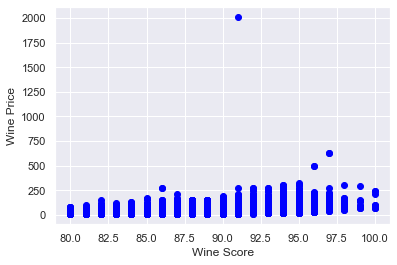

In [9]:
plt.scatter(cleaned_data['points'], cleaned_data['price'], c="blue", marker='o')
plt.xlabel("Wine Score")
plt.ylabel("Wine Price")
plt.savefig("screenshots/price-winescores-woutliers", dpi=90, format='png')

Initally KMeans setup to arbitrarely choose number of clusters based on visualization

In [10]:
scores_price_ds = cleaned_data[['points', 'price']]

In [11]:
kmeans = KMeans(n_clusters=3, init='k-means++')
kmeans.fit(scores_price_ds)
results = kmeans.predict(scores_price_ds)

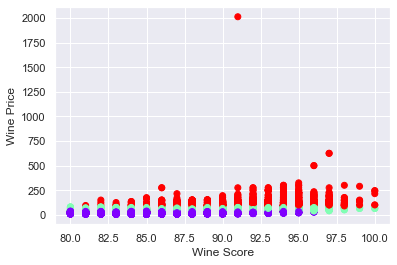

In [13]:
plt.scatter(cleaned_data['points'], cleaned_data['price'], c=results, marker='o', cmap='rainbow')
plt.xlabel("Wine Score")
plt.ylabel("Wine Price")
plt.savefig("screenshots/random-clustering-wine-price", dpi=90, format='png')

Employing Elbow method to determin number of clusters

In [14]:
inertia = []
for i in range(1,10):
    kmeans = KMeans(n_clusters=i, init='k-means++')
    kmeans.fit(scores_price_ds)
    print(kmeans.inertia_)
    inertia.append(kmeans.inertia_)

28472444.983613975
15475343.176401278
10310754.095787285
6753514.5726003265
4341958.519375221
3151595.2025676267
2307070.3953450373
1900160.1528196
1482234.244301133


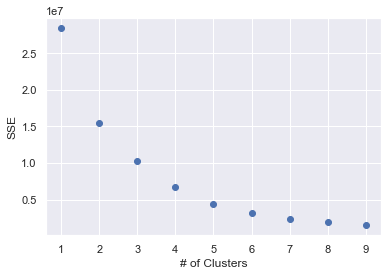

In [16]:
clusters = range(1,10)
plt.scatter(clusters, inertia)
plt.xlabel("# of Clusters")
plt.ylabel("SSE")
plt.savefig("screenshots/elbow-winescores-woutliers", dpi=90, format='png')

In [30]:
kmeans = KMeans(n_clusters=2, init='k-means++')
kmeans.fit(scores_price_ds)
results = kmeans.predict(scores_price_ds)

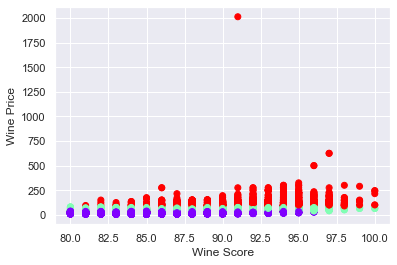

In [17]:
plt.scatter(cleaned_data['points'], cleaned_data['price'], c=results, marker='o', cmap='rainbow')
plt.xlabel("Wine Score")
plt.ylabel("Wine Price")
plt.savefig("screenshots/cluster-wineprice-woutliers", dpi=90, format='png')

There seem to be several outliers within the dataset when comparing the price to the score. I will go ahead and remove these using the z-score test (any points that are more than 3 STD from the mean)

In [19]:
from scipy.stats import zscore
import numpy as np

z_score = zscore(scores_price_ds)
abs_z_score = np.abs(z_score)
filtered = (abs_z_score < 3).all(axis=1)
filtered_ds = scores_price_ds[filtered]

In [20]:
x1, y1 = scores_price_ds.shape
x, y = filtered_ds.shape
print("Number of outliers removed: {}".format(x1-x))

Number of outliers removed: 621


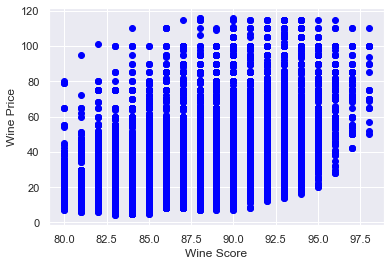

In [21]:
plt.scatter(filtered_ds['points'], filtered_ds['price'], c='blue', marker='o')
plt.xlabel("Wine Score")
plt.ylabel("Wine Price")
plt.savefig("screenshots/price-winescores-nooutliers", dpi=90, format='png')

Determining optimal number of clusters 

In [23]:
inertia = []
for i in range(1, 10):
    kmeans = KMeans(n_clusters=i, init='k-means++')
    kmeans.fit(filtered_ds)
    print("SSE: {}".format(kmeans.inertia_))
    inertia.append(kmeans.inertia_)

SSE: 14177376.123330085
SSE: 5282433.229264349
SSE: 2624475.6917199316
SSE: 1659394.0663053908
SSE: 1246104.7332949226
SSE: 950547.0205042954
SSE: 777286.9042431983
SSE: 664341.5297353966
SSE: 612801.620756826


Text(0, 0.5, 'SSE')

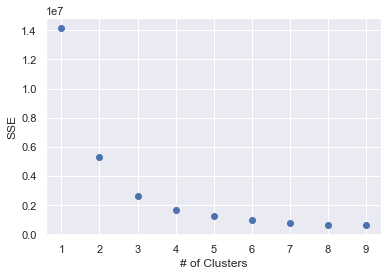

In [24]:
plt.scatter(clusters, inertia)
plt.xlabel("# of Clusters")
plt.ylabel("SSE")

In [25]:
kmeans = KMeans(n_clusters=2, init='k-means++')
kmeans.fit(filtered_ds)
result = kmeans.predict(filtered_ds)

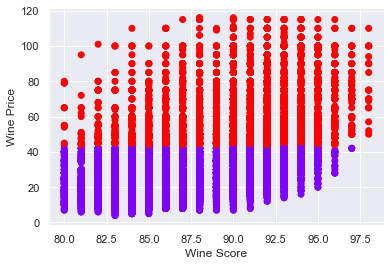

In [26]:
plt.scatter(filtered_ds['points'], filtered_ds['price'], c=result, marker='o', cmap='rainbow')
plt.xlabel("Wine Score")
plt.ylabel("Wine Price")
plt.savefig("screenshots/cluster-price-winescores", dpi=90, format='png')

Next we are going to run the experiment in price vs the type of wine to see if there is any correlation

In [27]:
price_variety_ds = cleaned_data[['price', 'variety']]

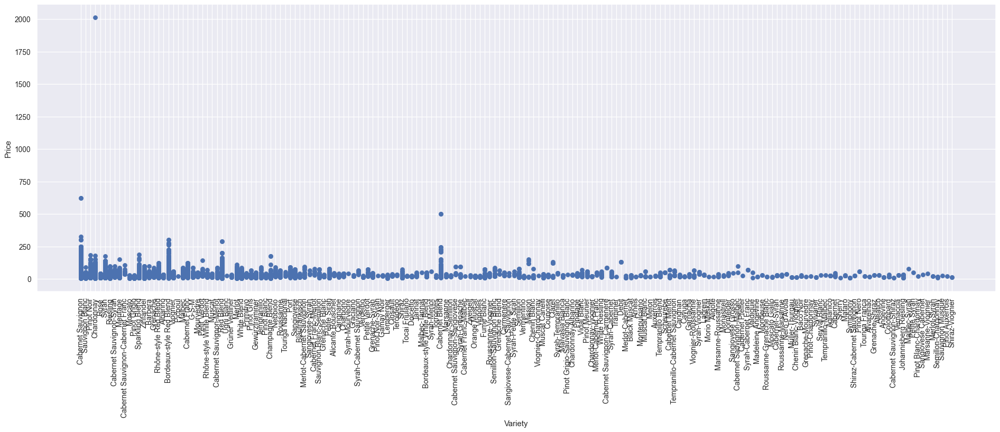

In [29]:
## Setting size of figure so it is easier to x labels
plt.figure(figsize=(26, 8), dpi=90) ## w, h
plt.scatter(price_variety_ds['variety'], price_variety_ds['price'])
plt.xlabel("Variety")
plt.xticks(rotation=90)
plt.ylabel("Price")
plt.savefig("screenshots/variety-price", dpi=90, format='png')

Employing Elbow method to determin best number of clusters

In [30]:
## Mapping Variety to integer values for clustering
var = price_variety_ds['variety'].unique() ## 180 unique varietys
price_variety_ds['mapped_variety'] = price_variety_ds['variety'].rank(method='dense', ascending=False).astype(int)
mapped_ds = price_variety_ds[['price', 'mapped_variety']]

In [31]:
inertia = []
for i in range(1, 20):
    kmeans = KMeans(n_clusters=i, init='k-means++')
    kmeans.fit(mapped_ds)
    print("SSE: {}".format(kmeans.inertia_))
    inertia.append(kmeans.inertia_)

SSE: 132419009.18967602
SSE: 47779071.94912162
SSE: 34314957.43488291
SSE: 25015166.431040853
SSE: 20959905.888793226
SSE: 17865220.30924952
SSE: 14504053.445864292
SSE: 11818041.479504768
SSE: 9769850.36589024
SSE: 8718560.657264082
SSE: 7255545.3181428015
SSE: 6463509.709814468
SSE: 5852638.222519076
SSE: 5394537.332624141
SSE: 5225963.843670118
SSE: 4768619.488117193
SSE: 4214071.446068309
SSE: 4090363.736918446
SSE: 3775977.1894797087


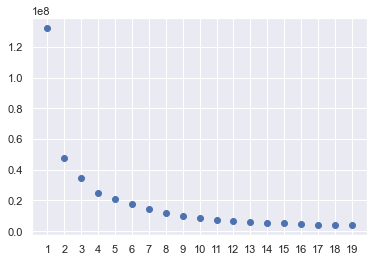

In [32]:
plt.scatter(range(1,20), inertia)
plt.xticks(range(1,20))
plt.savefig("screenshots/elbow-variety-price", dpi=90, format='png')

Running clusters based on elbow method and saving results back to dataframe

In [33]:
kmeans = KMeans(n_clusters=2, init='k-means++')
kmeans.fit(mapped_ds)
result = kmeans.predict(mapped_ds)
price_variety_ds['cluster'] = result

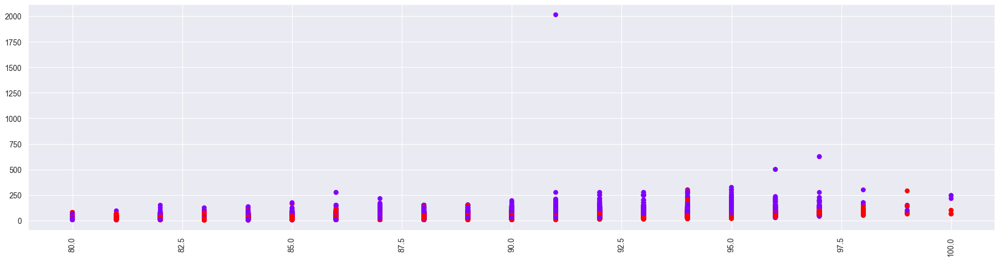

In [35]:
plt.figure(figsize=(25,6), dpi=90)
plt.scatter(cleaned_data['points'], price_variety_ds['price'], c=price_variety_ds['cluster'], marker='o', cmap='rainbow')
plt.xticks(rotation=90)
plt.savefig("screenshots/cluster-price-winescores-woutliers", dpi=90, format='png')